In [3]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Tue Jun  7 12:02:15 2022

@author: sunms498
"""

'\nCreated on Tue Jun  7 12:02:15 2022\n\n@author: sunms498\n'

## Load libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import xarray as xr
from os import walk
import pickle
from pathlib import Path
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame
import matplotlib.colors as colors
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
from pathlib import Path
from matplotlib.colors import LogNorm
import cmcrameri.cm as cmc
import cmocean as cmo
ds=2.6 #bulk density of marine soil
import sys
module_path = Path().resolve().parents[1] / "src" / "postprocessing"

# Append the directory to sys.path
sys.path.append(str(module_path))


from visualizePredictionMap import *

## Load data

In [6]:
#Load prediction maps and uncertainty maps from the monte carlo dropout for both continental shelves and deep ocean models

filename = Path().resolve().parents[1] / "data" / "output" / "predictionmaps_TOC" / "prediction_map_TOC_supervised_men_CS_KNN.npy"
prediction_map_CS = np.load(filename)
prediction_map_DO = np.load(Path().resolve().parents[1] / "data" / "output" / "predictionmaps_TOC" / "prediction_map_TOC_supervised_men_DO_KNN.npy")

#prediction_map_CS = np.rot90(np.rot90(np.fliplr(prediction_map_CS)))
#prediction_map_DO = np.rot90(np.rot90(np.fliplr(prediction_map_DO)))

In [4]:
#Path().resolve().parents[1] / "data" / "output" / "predictionmaps_TOC" / "prediction_map_TOC_supervised_men_DO_RF_v2.npy"

In [5]:
# Overlap both the deep ocean and the continental shelves
# pm: prediction map, um_uncertaintymap
dataset_mask = np.load(Path().resolve().parents[1] / "data" / "interim" / "masks" / "mask_deepocean.npy")
dataset_mask = np.rot90(np.rot90(np.fliplr(dataset_mask)))

# Create a copy of pm_CS
pm_overlapped = np.copy(prediction_map_DO)

# Mask the values from pm_CS where mask contains NaN values
pm_overlapped[np.isnan(dataset_mask)] = prediction_map_CS[np.isnan(dataset_mask)]



In [29]:
#load porosity file

file_porosity = Path().resolve().parents[1] / "data" / "interim" / "porosity" / "grl53425-sup-0002-supinfo.grd"
#file_porosity = "file_porosity = "/home/sunms498/Data/paper_porosity/GPSM_Restreppo/prediction.nc""
rootgrp_porosity = xr.open_dataset(Path(file_porosity), format = 'NETCDF4')
                                                                   
dataset_porosity = rootgrp_porosity.variables['z']

dataset_numpy_porosity = dataset_porosity.to_numpy()
dataset_numpy_porosity = np.rot90(np.rot90(np.fliplr(dataset_numpy_porosity)))

/gxfs_home/cau/sunms498/.conda/envs/pytorch/lib/python3.11/site-packages/xarray/backends/plugins.py:68: RuntimeWarning: Engine 'cfgrib' loading failed:
Cannot find the ecCodes library
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)


In [30]:

# make area of the cells file, based on the latitude


restrepo_features_path = Path().resolve().parents[1] / "data" / "raw" / "features" / "FeaturesPhrampusLee_TOCSedRate_updated" / "GL_LATITUDE_DD.5m.nc"
restrepo_files = []

for (dirpath, dirnames, filenames) in walk(restrepo_features_path):
    restrepo_files.extend(filenames)

restrepo_files.sort()
len(restrepo_files)

rootgrp = xr.open_dataset(restrepo_features_path, format = 'NETCDF4')
latitudes = rootgrp.variables['lat']
longitudes = rootgrp.variables['lon']


file_idx = -1
corrupted_files = 0

rootgrp = xr.open_dataset(restrepo_features_path, format = 'NETCDF4')

dataset = rootgrp.variables['data']
area = 9.297**2 * np.cos(dataset/180 * np.pi) # in km2

In [31]:
# overlay land boundaries on the prediction and uncertainty maps

land_file = Path().resolve().parents[1] / "data" / "raw" / "island_map.npy"
land_map = np.load(land_file)
land_map[np.isnan(land_map)] = 1


pm_overlapped[land_map] = np.nan


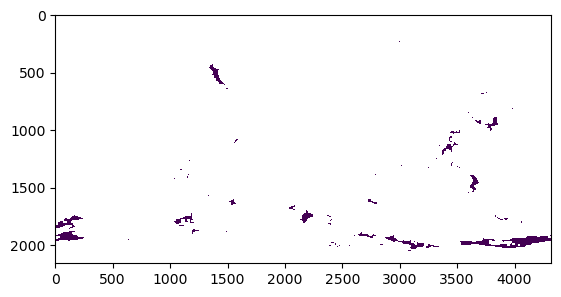

In [32]:
dataset_mask = np.load(Path().resolve().parents[1] / "data" / "interim" / "masks" / "mask_continentalshelves.npy")
plt.imshow(dataset_mask)

## Visualise

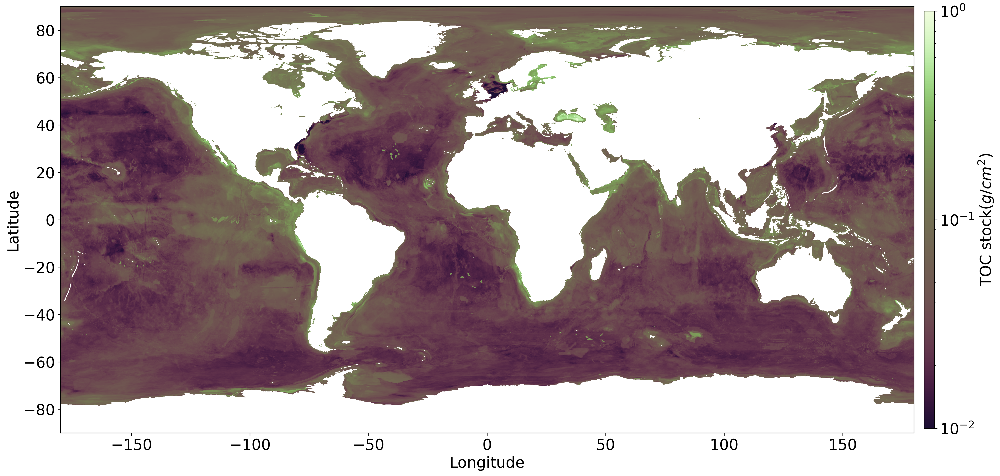

In [33]:
tocGlobal = (1-(dataset_numpy_porosity/100))*ds*(pm_overlapped/100)*10
VisualiseMap(tocGlobal, cmap = cmc.tokyo, use_log_norm=True, vmin=1e-2, vmax=1, cbar_label= "TOC stock($g/cm^2$)")

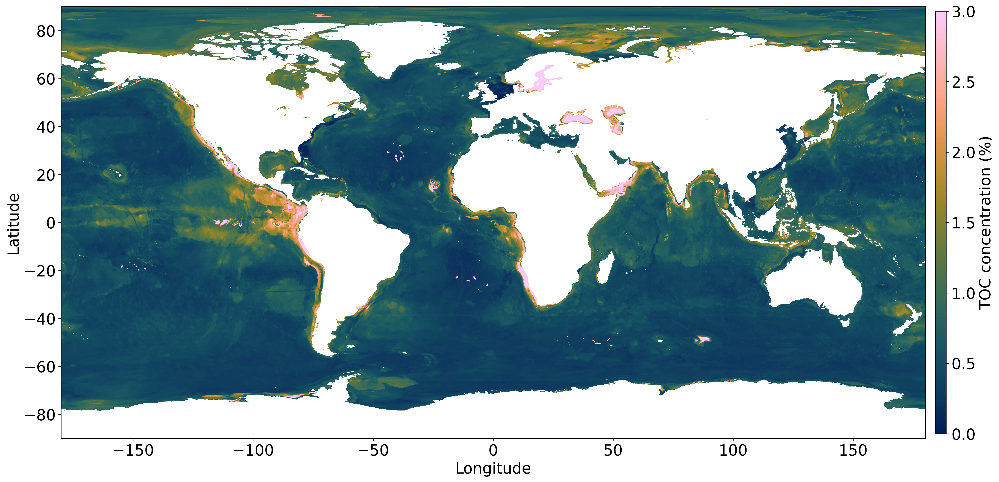

In [34]:
VisualiseMap(pm_overlapped, cmap=cmc.batlow, use_log_norm=False, vmin=0, vmax=3, cbar_label= "TOC concentration (%)")#cmc.tokyo#"cubehelix"

In [ ]:
#np.save("pm_toc_Conc_after.npy",pm_overlapped)

In [ ]:
area_np = np.array(area) # in km²:  10¹⁰ cm² = 1 km²
tocGlobal_g = np.multiply(tocGlobal,area_np)*1e10 # in g
VisualiseMap(tocGlobal_g/1e15, cmap=cmc.batlow, use_log_norm=True, vmin=1e-6, vmax=1e-3, cbar_label= "TOC stock ($Pg$)")

In [ ]:
area_np = np.array(area) # in km²:  10¹⁰ cm² = 1 km²

area_np_land = area_np
area_np_land[land_map]= 0
VisualiseMap(area_np_land, cmap=cmc.oslo, vmax=90, cbar_label='Cell area ($km^2$)')

In [ ]:
tocPercent_cellwise = np.multiply(pm_overlapped,area_np) # in % km²
VisualiseMap(tocPercent_cellwise, cmap=cmo.cm.haline, use_log_norm=True,vmin=1e1, vmax=1e3, cbar_label= "TOC concentration (%)")

## Analyse

In [ ]:
# Make geo dataframes and plot them
import geopandas as gpd
from rasterio.features import geometry_mask
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm


resolution = 5 / 60  # 5 arc minutes in degrees
lon = np.arange(-180, 180, resolution)
lat = np.arange(-90, 90, resolution)


tocPercent_cellwise_rot = np.rot90(np.rot90(np.fliplr(tocPercent_cellwise)))
area_np_land_rot = np.rot90(np.rot90(np.fliplr(area_np_land)))
tocGlobal_g_rot = np.rot90(np.rot90(np.fliplr(tocGlobal_g)))
continentalshelves_mask = np.load(Path().resolve().parents[1] / "data" / "interim" / "masks" / "mask_continentalshelves.npy")
#continentalshelves_mask_rot = np.rot90(np.rot90(np.fliplr(continentalshelves_mask)))

# Create a GeoDataFrame with the prediction values and their corresponding geometry
lon_mesh, lat_mesh = np.meshgrid(lon, lat)
tocPercentcCellwise_gdf = gpd.GeoDataFrame(
    data={'TOCPercent': tocPercent_cellwise_rot.flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)
prediction_gdf = gpd.GeoDataFrame(
    data={'TOC': tocGlobal_g_rot.flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)
area_gdf = gpd.GeoDataFrame(
    data={'area': np.array(area_np_land_rot).flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)
continentalshelves_gdf = gpd.GeoDataFrame(
    data={'continentalshelves': np.array(continentalshelves_mask).flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)


# Downsample the GeoDataFrame by taking every nth point
n = 100  # Adjust this value based on your desired level of downsampling
downsampled_gdf = prediction_gdf.iloc[::n, :]

# Plot the downsampled GeoDataFrame
downsampled_gdf.plot(column='TOC', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('TOC density Map (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

downsampled_gdf = area_gdf.iloc[::n, :]

# Plot the downsampled GeoDataFrame
downsampled_gdf.plot(column='area', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('Area Map (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

downsampled_gdf = tocPercentcCellwise_gdf.iloc[::n, :]

downsampled_gdf.plot(column='TOCPercent', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('TOC Conc. Map (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

downsampled_gdf = continentalshelves_gdf.iloc[::n, :]

downsampled_gdf.plot(column='continentalshelves', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('Continental shelves (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

,name,latitude,longitude,min_Y,min_X,max_Y,max_X,area_km2,geometry
0,Southern Ocean,-68.03985,-26.63275,-85.56250,-180.00000,-60.00000,180.00000,6793589,"POLYGON ((180.00000 -60.00000, 180.00000 -84.3..."
1,South Atlantic Ocean,-33.73758,-18.83411,-60.00000,-69.60084,0.07511,20.00000,42815540,"MULTIPOLYGON (((-50.68008 0.00000, -50.64339 0..."
2,South Pacific Ocean,-30.09612,-143.06088,-60.00000,130.11129,3.39114,-67.26667,90147400,"MULTIPOLYGON (((-70.93199 -54.75580, -70.92427..."
3,North Pacific Ocean,26.95013,-169.38334,0.00000,117.51622,66.56286,-76.98544,77124830,"MULTIPOLYGON (((157.14844 57.76842, 157.15257 ..."
4,South China and Easter Archipelagic Seas,5.62943,115.46548,-10.92259,95.43328,25.56728,134.03155,6822162,"MULTIPOLYGON (((119.28261 25.48829, 119.27451 ..."
5,Indian Ocean,-27.27272,79.60241,-60.00000,20.00000,31.18586,146.91671,78162363,"MULTIPOLYGON (((56.08700 27.10831, 56.08874 27..."
6,Mediterranean Region,38.13065,19.70067,30.06809,-6.03255,47.37640,42.35496,2988248,"POLYGON ((32.57319 30.06809, 32.56996 30.06817..."
7,Baltic Sea,58.78478,19.22115,52.65352,9.36560,67.08059,30.34710,415600,"POLYGON ((27.35543 60.48886, 27.35988 60.48797..."
8,North Atlantic Ocean,31.77621,-40.24758,-0.93603,-98.05392,68.63872,12.00594,41741693,"MULTIPOLYGON (((-29.42622 68.22895, -23.13435 ..."
9,Arctic Ocean,79.14792,-3.28568,51.14359,-180.00000,90.00000,180.00000,15571669,"MULTIPOLYGON (((178.29612 69.42748, 178.29961 ..."


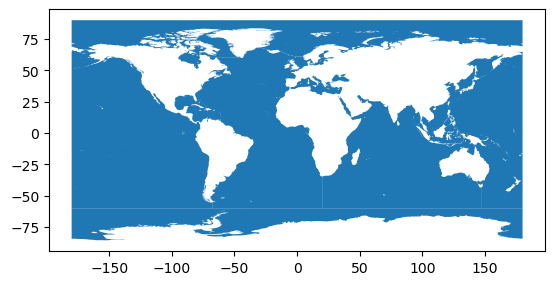

In [15]:
ocean_gdf = gpd.read_file(Path().resolve().parents[1] / "data" / "interim" / "GOaS_v1_20211214" / "goas_v01.shp")
ocean_gdf.plot()
ocean_gdf

In [16]:
# Find the sum of TOC stock, TOC Percent and area in each ocean region
joined_gdf = gpd.sjoin(prediction_gdf, ocean_gdf, predicate='within')
joined_area_gdf = gpd.sjoin(area_gdf, ocean_gdf, predicate='within')
joined_gdf_tocPercent = gpd.sjoin(tocPercentcCellwise_gdf, ocean_gdf, predicate='within')

In [17]:
# Calculate the sum of TOC in each polygon
sum_toc_by_polygon = (joined_gdf.groupby('name')['TOC']).sum()

# Print the sum of TOC in each polygon
for ocean_name, toc_sum in sum_toc_by_polygon.items():
    print(f"Sum of TOC  in {ocean_name}: {toc_sum/1e15} Pg")

Sum of TOC  in Arctic Ocean: 12.66581290892132 Pg
Sum of TOC  in Baltic Sea: 0.7753672059525895 Pg
Sum of TOC  in Indian Ocean: 28.38871337563948 Pg
Sum of TOC  in Mediterranean Region: 2.52736683688386 Pg
Sum of TOC  in North Atlantic Ocean: 17.659180488281848 Pg
Sum of TOC  in North Pacific Ocean: 33.83520437080018 Pg
Sum of TOC  in South Atlantic Ocean: 13.988568468679766 Pg
Sum of TOC  in South China and Easter Archipelagic Seas: 4.092375017837112 Pg
Sum of TOC  in South Pacific Ocean: 34.150667699010796 Pg
Sum of TOC  in Southern Ocean: 6.577332928760015 Pg


In [18]:
# Calculate the sum of TOC Percent weighted by the area of the cells in each polygon
sum_toc_by_polygon = (joined_gdf_tocPercent.groupby('name')['TOCPercent']).sum()

# Print the sum of TOC in each polygon
for ocean_name, toc_sum in sum_toc_by_polygon.items():
    print(f"Sum of TOC Percent in {ocean_name}: {toc_sum/1e6} %km2 (x1e6)")

Sum of TOC Percent in Arctic Ocean: 13.773997992067695 %km2 (x1e6)
Sum of TOC Percent in Baltic Sea: 1.1946753647378185 %km2 (x1e6)
Sum of TOC Percent in Indian Ocean: 39.57561191764197 %km2 (x1e6)
Sum of TOC Percent in Mediterranean Region: 3.013169391601125 %km2 (x1e6)
Sum of TOC Percent in North Atlantic Ocean: 24.200256559922725 %km2 (x1e6)
Sum of TOC Percent in North Pacific Ocean: 51.81929939985715 %km2 (x1e6)
Sum of TOC Percent in South Atlantic Ocean: 21.270516232775712 %km2 (x1e6)
Sum of TOC Percent in South China and Easter Archipelagic Seas: 4.594961016012105 %km2 (x1e6)
Sum of TOC Percent in South Pacific Ocean: 50.167955772998624 %km2 (x1e6)
Sum of TOC Percent in Southern Ocean: 9.028818715366695 %km2 (x1e6)


In [19]:
# Calculate the area in each polygon
area_by_polygon = (joined_area_gdf.groupby('name')['area']).sum()

# Print the sum of TOC in each polygon
for ocean_name, area in area_by_polygon.items():
    print(f"Area of {ocean_name}: {area/1e6} million km^2")

Area of Arctic Ocean: 15.185819 million km^2
Area of Baltic Sea: 0.392735125 million km^2
Area of Indian Ocean: 71.160768 million km^2
Area of Mediterranean Region: 2.91881925 million km^2
Area of North Atlantic Ocean: 41.721284 million km^2
Area of North Pacific Ocean: 77.248968 million km^2
Area of South Atlantic Ocean: 40.530364 million km^2
Area of South China and Easter Archipelagic Seas: 6.7387235 million km^2
Area of South Pacific Ocean: 85.270424 million km^2
Area of Southern Ocean: 20.73395 million km^2


In [20]:
# Calculate the mean TOC percent for each polygon
mean_toc_percent_by_polygon = sum_toc_by_polygon / area_by_polygon

# Print the mean TOC percent in each polygon
for ocean_name, mean_toc_percent in mean_toc_percent_by_polygon.items():
    print(f"Mean TOC Percent in {ocean_name}: {mean_toc_percent} %")

Mean TOC Percent in Arctic Ocean: 0.907030301893345 %
Mean TOC Percent in Baltic Sea: 3.0419366353794266 %
Mean TOC Percent in Indian Ocean: 0.5561436874548905 %
Mean TOC Percent in Mediterranean Region: 1.0323247633785904 %
Mean TOC Percent in North Atlantic Ocean: 0.5800458240911934 %
Mean TOC Percent in North Pacific Ocean: 0.6708089537177655 %
Mean TOC Percent in South Atlantic Ocean: 0.5248044708598154 %
Mean TOC Percent in South China and Easter Archipelagic Seas: 0.6818740991542546 %
Mean TOC Percent in South Pacific Ocean: 0.5883394666009708 %
Mean TOC Percent in Southern Ocean: 0.43546061967771194 %


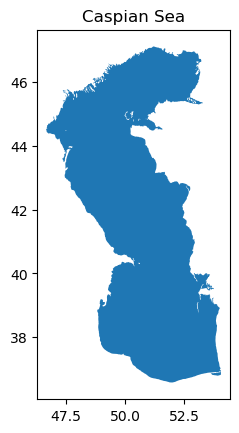

TOC stock inside the Caspian Sea: 0.7218907160755395 Pg
Area inside the Caspian Sea: 0.37953628125 million km^2
TOC Percent inside the Caspian Sea: 0.8635663212619077 % (1e6)
Mean TOC Percent inside the Caspian Sea: 2.2753195515795177 % 


In [21]:
caspian_sea_gdf = gpd.read_file(Path().resolve().parents[1] / "data" / "interim" / "GOaS_v1_20211214" / "worldglwd1.shp")
caspian_sea_gdf.plot()
plt.title('Caspian Sea')
plt.show()
# Reproject caspian_sea_gdf to EPSG:4326
caspian_sea_gdf = caspian_sea_gdf.to_crs(epsg=4326)

# Perform spatial join
joined_gdf_caspian = gpd.sjoin(prediction_gdf, caspian_sea_gdf, how="left", predicate="within")
joined_gdf_caspian_tocPercent = gpd.sjoin(tocPercentcCellwise_gdf, caspian_sea_gdf, predicate='within')
joined_gdf_caspian_area = gpd.sjoin(area_gdf, caspian_sea_gdf, how="left", predicate="within")

# Check the TOC values inside and outside the Caspian Sea
toc_inside_caspian = np.nansum(joined_gdf_caspian[joined_gdf_caspian['lake_name'].notna()]['TOC'])
toc_outside_caspian = np.nansum(joined_gdf_caspian[joined_gdf_caspian['lake_name'].isna()]['TOC'])

print(f"TOC stock inside the Caspian Sea: {toc_inside_caspian/1e15} Pg")
#print(f"TOC stock outside the Caspian Sea: {toc_outside_caspian/1e15} Gt")

# Perform spatial join

# Check the TOC values inside and outside the Caspian Sea
area_inside_caspian = np.nansum(joined_gdf_caspian_area[joined_gdf_caspian_area['lake_name'].notna()]['area'])
area_outside_caspian = np.nansum(joined_gdf_caspian_area[joined_gdf_caspian_area['lake_name'].isna()]['area'])

print(f"Area inside the Caspian Sea: {area_inside_caspian/1e6} million km^2")
#print(f"Area outside the Caspian Sea: {area_outside_caspian/1e6} million km^2")

# Check the TOC values inside and outside the Caspian Sea
tocPercent_inside_caspian = np.nansum(joined_gdf_caspian_tocPercent[joined_gdf_caspian_tocPercent['lake_name'].notna()]['TOCPercent'])
tocPercent_outside_caspian = np.nansum(joined_gdf_caspian_tocPercent[joined_gdf_caspian_tocPercent['lake_name'].isna()]['TOCPercent'])

print(f"TOC Percent inside the Caspian Sea: {tocPercent_inside_caspian/1e6} % (1e6)")
print(f"Mean TOC Percent inside the Caspian Sea: {tocPercent_inside_caspian/area_inside_caspian} % ")



In [ ]:
# get the toc map for the continental shelves
dataset_mask = np.load(Path().resolve().parents[1] / "data" / "interim" / "masks" / "mask_deepocean.npy")
dataset_mask = np.rot90(np.rot90(np.fliplr(dataset_mask)))

# Create a copy of tocGlobal_CS
tocGlobal_g_CS_masked = np.copy(tocGlobal_g)
# Use boolean indexing to set values to nan where dataset_mask is not nan
tocGlobal_g_CS_masked[~np.isnan(dataset_mask)] = np.nan


tocPercent_cellwise_CS_masked = np.copy(tocPercent_cellwise)
# Use boolean indexing to set values to nan where dataset_mask is not nan
tocPercent_cellwise_CS_masked[~np.isnan(dataset_mask)] = np.nan

area_np_land_CS_masked = np.copy(area_np_land)
# Use boolean indexing to set values to nan where dataset_mask is not nan
area_np_land_CS_masked[~np.isnan(dataset_mask)] = np.nan

VisualiseMap(tocGlobal_g_CS_masked/1e15, cmap=cmc.batlow, use_log_norm=True, vmin=1e-6, vmax=1e-3, cbar_label= "TOC stock ($Pg$)")
VisualiseMap(tocPercent_cellwise_CS_masked, cmap=cmo.cm.haline, use_log_norm=True,vmin=1e1, vmax=1e3, cbar_label= "TOC concentration (%)")
VisualiseMap(area_np_land_CS_masked, cmap=cmc.oslo, vmax=90, cbar_label='Cell area ($km^2$)')


In [ ]:

tocPercent_cellwise_CS_masked_rot = np.rot90(np.rot90(np.fliplr(tocPercent_cellwise_CS_masked)))
area_np_land_CS_masked_rot = np.rot90(np.rot90(np.fliplr(area_np_land_CS_masked)))
tocGlobal_g_CS_masked_rot = np.rot90(np.rot90(np.fliplr(tocGlobal_g_CS_masked)))
# Create a GeoDataFrame with the prediction values and their corresponding geometry
lon_mesh, lat_mesh = np.meshgrid(lon, lat)
tocPercentcCellwise_CS_masked_gdf = gpd.GeoDataFrame(
    data={'TOCPercent': tocPercent_cellwise_CS_masked_rot.flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)
prediction_CS_masked_gdf = gpd.GeoDataFrame(
    data={'TOC': tocGlobal_g_CS_masked_rot.flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)
area_CS_masked_gdf = gpd.GeoDataFrame(
    data={'area': np.array(area_np_land_CS_masked_rot).flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)
continentalshelves_gdf = gpd.GeoDataFrame(
    data={'continentalshelves': np.array(continentalshelves_mask).flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)


# Downsample the GeoDataFrame by taking every nth point
n = 100  # Adjust this value based on your desired level of downsampling
downsampled_gdf = prediction_CS_masked_gdf.iloc[::n, :]

# Plot the downsampled GeoDataFrame
downsampled_gdf.plot(column='TOC', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('TOC density Map (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

downsampled_gdf = area_CS_masked_gdf.iloc[::n, :]

# Plot the downsampled GeoDataFrame
downsampled_gdf.plot(column='area', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('Area Map (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

downsampled_gdf = tocPercentcCellwise_CS_masked_gdf.iloc[::n, :]

downsampled_gdf.plot(column='TOCPercent', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('TOC Conc. Map (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

downsampled_gdf = continentalshelves_gdf.iloc[::n, :]

downsampled_gdf.plot(column='continentalshelves', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('Continental shelves (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

In [24]:
# Perform a spatial join to associate each point with the corresponding polygon
joined_gdf = gpd.sjoin(prediction_CS_masked_gdf, ocean_gdf, predicate='within')
joined_area_gdf = gpd.sjoin(area_CS_masked_gdf, ocean_gdf, predicate='within')
# Perform a spatial join to associate each point with the corresponding polygon
joined_gdf_TOCPercent = gpd.sjoin(tocPercentcCellwise_CS_masked_gdf, ocean_gdf, predicate='within')

In [25]:
# Calculate the sum of TOC in each polygon
sum_toc_by_polygon = (joined_gdf.groupby('name')['TOC']).sum()

# Print the sum of TOC in each polygon
for ocean_name, toc_sum in sum_toc_by_polygon.items():
    print(f"Sum of TOC between 0m and 200m of {ocean_name}: {toc_sum/1e15} Pg")

Sum of TOC between 0m and 200m of Arctic Ocean: 5.57809965525508 Pg
Sum of TOC between 0m and 200m of Baltic Sea: 0.7715944281158089 Pg
Sum of TOC between 0m and 200m of Indian Ocean: 2.6365653187812654 Pg
Sum of TOC between 0m and 200m of Mediterranean Region: 0.6094393276393443 Pg
Sum of TOC between 0m and 200m of North Atlantic Ocean: 2.8169390466519264 Pg
Sum of TOC between 0m and 200m of North Pacific Ocean: 2.741796805145176 Pg
Sum of TOC between 0m and 200m of South Atlantic Ocean: 1.2469407101221628 Pg
Sum of TOC between 0m and 200m of South China and Easter Archipelagic Seas: 1.5609363059363537 Pg
Sum of TOC between 0m and 200m of South Pacific Ocean: 1.2626087761691722 Pg
Sum of TOC between 0m and 200m of Southern Ocean: 0.21070539339736824 Pg


In [26]:
# Calculate the sum of TOC in each polygon
sum_toc_by_polygon = (joined_gdf_TOCPercent.groupby('name')['TOCPercent']).sum()

# Print the sum of TOC in each polygon
for ocean_name, toc_sum in sum_toc_by_polygon.items():
    print(f"Sum of TOC % between 0m and 200m of {ocean_name}: {toc_sum/1e6} %km^2 (1e6)")

Sum of TOC % between 0m and 200m of Arctic Ocean: 5.391572264687843 %km^2 (1e6)
Sum of TOC % between 0m and 200m of Baltic Sea: 1.1870291685420287 %km^2 (1e6)
Sum of TOC % between 0m and 200m of Indian Ocean: 2.479297085155623 %km^2 (1e6)
Sum of TOC % between 0m and 200m of Mediterranean Region: 0.6426406634176968 %km^2 (1e6)
Sum of TOC % between 0m and 200m of North Atlantic Ocean: 2.6831620735476633 %km^2 (1e6)
Sum of TOC % between 0m and 200m of North Pacific Ocean: 2.5381256880602376 %km^2 (1e6)
Sum of TOC % between 0m and 200m of South Atlantic Ocean: 1.5382555928975177 %km^2 (1e6)
Sum of TOC % between 0m and 200m of South China and Easter Archipelagic Seas: 1.4458915742733545 %km^2 (1e6)
Sum of TOC % between 0m and 200m of South Pacific Ocean: 1.4911629622984177 %km^2 (1e6)
Sum of TOC % between 0m and 200m of Southern Ocean: 0.3413745146409678 %km^2 (1e6)


In [27]:
# Calculate the sum of TOC in each polygon
area_by_polygon = (joined_area_gdf.groupby('name')['area']).sum()

# Print the sum of TOC in each polygon
for ocean_name, area in area_by_polygon.items():
    print(f"Area of  between 0m and 200m of {ocean_name}: {area/1e6} million km^2")

Area of  between 0m and 200m of Arctic Ocean: 5.7236845 million km^2
Area of  between 0m and 200m of Baltic Sea: 0.39123490625 million km^2
Area of  between 0m and 200m of Indian Ocean: 4.06489675 million km^2
Area of  between 0m and 200m of Mediterranean Region: 0.652842625 million km^2
Area of  between 0m and 200m of North Atlantic Ocean: 4.2632085 million km^2
Area of  between 0m and 200m of North Pacific Ocean: 3.83248925 million km^2
Area of  between 0m and 200m of South Atlantic Ocean: 1.864818875 million km^2
Area of  between 0m and 200m of South China and Easter Archipelagic Seas: 2.99495775 million km^2
Area of  between 0m and 200m of South Pacific Ocean: 1.456509375 million km^2
Area of  between 0m and 200m of Southern Ocean: 0.574039 million km^2


In [28]:
# Calculate the mean TOC percent for each polygon
mean_toc_percent_by_polygon = sum_toc_by_polygon / area_by_polygon

# Print the mean TOC percent in each polygon
for ocean_name, mean_toc_percent in mean_toc_percent_by_polygon.items():
    print(f"Mean TOC Percent between 0m and 200m of {ocean_name}: {mean_toc_percent} %")

Mean TOC Percent between 0m and 200m of Arctic Ocean: 0.9419757963053071 %
Mean TOC Percent between 0m and 200m of Baltic Sea: 3.0340574155812012 %
Mean TOC Percent between 0m and 200m of Indian Ocean: 0.6099286741183827 %
Mean TOC Percent between 0m and 200m of Mediterranean Region: 0.984373015499251 %
Mean TOC Percent between 0m and 200m of North Atlantic Ocean: 0.6293762253353696 %
Mean TOC Percent between 0m and 200m of North Pacific Ocean: 0.6622655727110618 %
Mean TOC Percent between 0m and 200m of South Atlantic Ocean: 0.8248820373493472 %
Mean TOC Percent between 0m and 200m of South China and Easter Archipelagic Seas: 0.4827752826474278 %
Mean TOC Percent between 0m and 200m of South Pacific Ocean: 1.0237922171276224 %
Mean TOC Percent between 0m and 200m of Southern Ocean: 0.5946887139043998 %


In [ ]:
# get the toc map for the continental shelves
dataset_mask = np.load(Path().resolve().parents[1] / "data" / "interim" / "masks" / "mask_continentalshelves.npy")
dataset_mask = np.rot90(np.rot90(np.fliplr(dataset_mask)))

# Create a copy of tocGlobal_CS
tocGlobal_g_CS_masked = np.copy(tocGlobal_g)
# Use boolean indexing to set values to nan where dataset_mask is not nan
tocGlobal_g_CS_masked[~np.isnan(dataset_mask)] = np.nan


tocPercent_cellwise_CS_masked = np.copy(tocPercent_cellwise)
# Use boolean indexing to set values to nan where dataset_mask is not nan
tocPercent_cellwise_CS_masked[~np.isnan(dataset_mask)] = np.nan

area_np_land_CS_masked = np.copy(area_np_land)
# Use boolean indexing to set values to nan where dataset_mask is not nan
area_np_land_CS_masked[~np.isnan(dataset_mask)] = np.nan

VisualiseMap(tocGlobal_g_CS_masked/1e15, cmap=cmc.batlow, use_log_norm=True, vmin=1e-6, vmax=1e-3, cbar_label= "TOC stock ($Pg$)")
VisualiseMap(tocPercent_cellwise_CS_masked, cmap=cmo.cm.haline, use_log_norm=True,vmin=1e1, vmax=1e3, cbar_label= "TOC concentration (%)")
VisualiseMap(area_np_land_CS_masked, cmap=cmc.oslo, vmax=90, cbar_label='Cell area ($km^2$)')


In [ ]:

tocPercent_cellwise_CS_masked_rot = np.rot90(np.rot90(np.fliplr(tocPercent_cellwise_CS_masked)))
area_np_land_CS_masked_rot = np.rot90(np.rot90(np.fliplr(area_np_land_CS_masked)))
tocGlobal_g_CS_masked_rot = np.rot90(np.rot90(np.fliplr(tocGlobal_g_CS_masked)))
# Create a GeoDataFrame with the prediction values and their corresponding geometry
lon_mesh, lat_mesh = np.meshgrid(lon, lat)
tocPercentcCellwise_CS_masked_gdf = gpd.GeoDataFrame(
    data={'TOCPercent': tocPercent_cellwise_CS_masked_rot.flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)
prediction_CS_masked_gdf = gpd.GeoDataFrame(
    data={'TOC': tocGlobal_g_CS_masked_rot.flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)
area_CS_masked_gdf = gpd.GeoDataFrame(
    data={'area': np.array(area_np_land_CS_masked_rot).flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)
continentalshelves_gdf = gpd.GeoDataFrame(
    data={'continentalshelves': np.array(continentalshelves_mask).flatten()},
    geometry=gpd.points_from_xy(lon_mesh.flatten(), lat_mesh.flatten()),
    crs='EPSG:4326'
)


# Downsample the GeoDataFrame by taking every nth point
n = 100  # Adjust this value based on your desired level of downsampling
downsampled_gdf = prediction_CS_masked_gdf.iloc[::n, :]

# Plot the downsampled GeoDataFrame
downsampled_gdf.plot(column='TOC', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('TOC density Map (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

downsampled_gdf = area_CS_masked_gdf.iloc[::n, :]

# Plot the downsampled GeoDataFrame
downsampled_gdf.plot(column='area', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('Area Map (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

downsampled_gdf = tocPercentcCellwise_CS_masked_gdf.iloc[::n, :]

downsampled_gdf.plot(column='TOCPercent', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('TOC Conc. Map (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

downsampled_gdf = continentalshelves_gdf.iloc[::n, :]

downsampled_gdf.plot(column='continentalshelves', cmap='viridis', legend=True, markersize=1)

# Add title and labels
plt.title('Continental shelves (Downsampled)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

In [31]:
# Perform a spatial join to associate each point with the corresponding polygon
joined_gdf = gpd.sjoin(prediction_CS_masked_gdf, ocean_gdf, predicate='within')
joined_area_gdf = gpd.sjoin(area_CS_masked_gdf, ocean_gdf, predicate='within')
# Perform a spatial join to associate each point with the corresponding polygon
joined_gdf_TOCPercent = gpd.sjoin(tocPercentcCellwise_CS_masked_gdf, ocean_gdf, predicate='within')

In [32]:
# Calculate the sum of TOC in each polygon
sum_toc_by_polygon = (joined_gdf.groupby('name')['TOC']).sum()

# Print the sum of TOC in each polygon
for ocean_name, toc_sum in sum_toc_by_polygon.items():
    print(f"Sum of TOC between 0m and 200m of {ocean_name}: {toc_sum/1e15} Pg")

Sum of TOC between 0m and 200m of Arctic Ocean: 7.182175591304186 Pg
Sum of TOC between 0m and 200m of Baltic Sea: 0.04485577637856786 Pg
Sum of TOC between 0m and 200m of Indian Ocean: 25.85775999788588 Pg
Sum of TOC between 0m and 200m of Mediterranean Region: 1.9472062586893712 Pg
Sum of TOC between 0m and 200m of North Atlantic Ocean: 14.96189756120421 Pg
Sum of TOC between 0m and 200m of North Pacific Ocean: 31.16087364383307 Pg
Sum of TOC between 0m and 200m of South Atlantic Ocean: 12.758332391563687 Pg
Sum of TOC between 0m and 200m of South China and Easter Archipelagic Seas: 2.5809426453285265 Pg
Sum of TOC between 0m and 200m of South Pacific Ocean: 32.95810780371934 Pg
Sum of TOC between 0m and 200m of Southern Ocean: 6.391466552643172 Pg


In [33]:
# Calculate the sum of TOC in each polygon
sum_toc_by_polygon = (joined_gdf_TOCPercent.groupby('name')['TOCPercent']).sum()

# Print the sum of TOC in each polygon
for ocean_name, toc_sum in sum_toc_by_polygon.items():
    print(f"Sum of TOC % between 0m and 200m of {ocean_name}: {toc_sum/1e6} %km^2 (1e6)")

Sum of TOC % between 0m and 200m of Arctic Ocean: 8.490454340362396 %km^2 (1e6)
Sum of TOC % between 0m and 200m of Baltic Sea: 0.062250093411805096 %km^2 (1e6)
Sum of TOC % between 0m and 200m of Indian Ocean: 37.20821023409152 %km^2 (1e6)
Sum of TOC % between 0m and 200m of Mediterranean Region: 2.402064797132108 %km^2 (1e6)
Sum of TOC % between 0m and 200m of North Atlantic Ocean: 21.65763233357159 %km^2 (1e6)
Sum of TOC % between 0m and 200m of North Pacific Ocean: 49.356283744630375 %km^2 (1e6)
Sum of TOC % between 0m and 200m of South Atlantic Ocean: 19.755035946357808 %km^2 (1e6)
Sum of TOC % between 0m and 200m of South China and Easter Archipelagic Seas: 3.2055064224266894 %km^2 (1e6)
Sum of TOC % between 0m and 200m of South Pacific Ocean: 48.75949801034507 %km^2 (1e6)
Sum of TOC % between 0m and 200m of Southern Ocean: 8.742435304963136 %km^2 (1e6)


In [34]:
# Calculate the sum of TOC in each polygon
area_by_polygon = (joined_area_gdf.groupby('name')['area']).sum()

# Print the sum of TOC in each polygon
for ocean_name, area in area_by_polygon.items():
    print(f"Area of  between 0m and 200m of {ocean_name}: {area/1e6} million km^2")

Area of  between 0m and 200m of Arctic Ocean: 9.569597 million km^2
Area of  between 0m and 200m of Baltic Sea: 0.015872580078125 million km^2
Area of  between 0m and 200m of Indian Ocean: 67.267192 million km^2
Area of  between 0m and 200m of Mediterranean Region: 2.2994795 million km^2
Area of  between 0m and 200m of North Atlantic Ocean: 37.601844 million km^2
Area of  between 0m and 200m of North Pacific Ocean: 73.517864 million km^2
Area of  between 0m and 200m of South Atlantic Ocean: 38.694404 million km^2
Area of  between 0m and 200m of South China and Easter Archipelagic Seas: 3.8373615 million km^2
Area of  between 0m and 200m of South Pacific Ocean: 83.914136 million km^2
Area of  between 0m and 200m of Southern Ocean: 20.251808 million km^2


In [35]:
# Calculate the mean TOC percent for each polygon
mean_toc_percent_by_polygon = sum_toc_by_polygon / area_by_polygon

# Print the mean TOC percent in each polygon
for ocean_name, mean_toc_percent in mean_toc_percent_by_polygon.items():
    print(f"Mean TOC Percent between 0m and 200m of {ocean_name}: {mean_toc_percent} %")

Mean TOC Percent between 0m and 200m of Arctic Ocean: 0.8872321729287447 %
Mean TOC Percent between 0m and 200m of Baltic Sea: 3.9218635600141565 %
Mean TOC Percent between 0m and 200m of Indian Ocean: 0.5531405299940501 %
Mean TOC Percent between 0m and 200m of Mediterranean Region: 1.0446123990807954 %
Mean TOC Percent between 0m and 200m of North Atlantic Ocean: 0.5759726127679161 %
Mean TOC Percent between 0m and 200m of North Pacific Ocean: 0.6713508943163852 %
Mean TOC Percent between 0m and 200m of South Atlantic Ocean: 0.5105398689267266 %
Mean TOC Percent between 0m and 200m of South China and Easter Archipelagic Seas: 0.83534126832374 %
Mean TOC Percent between 0m and 200m of South Pacific Ocean: 0.581064172672231 %
Mean TOC Percent between 0m and 200m of Southern Ocean: 0.4316866575548779 %


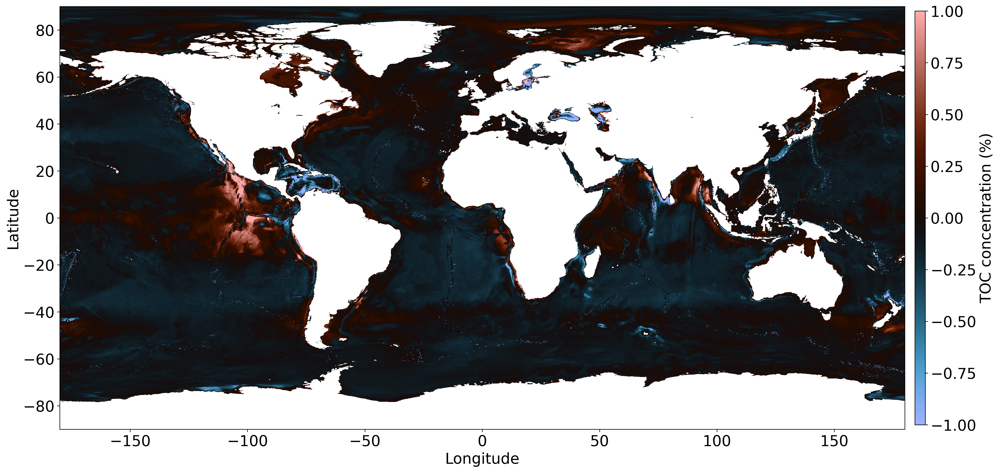

In [44]:
pm_before = np.load("pm_toc_Conc_before.npy")
pm_after = np.load("pm_toc_Conc_after.npy")
VisualiseMap(pm_after - pm_before, cmap=cmc.berlin, use_log_norm=False, vmax = 1, vmin = -1, cbar_label= "TOC concentration (%)")

In [45]:
import numpy as np
import scipy.io as sio

# Load the NumPy array from the file
pm_after = np.load("pm_toc_Conc_after.npy")

# Save the array to a .mat file
sio.savemat("pm_toc_Conc_after.mat", {'pm_after': pm_after})

In [ ]:
import scipy.io as sio
import matplotlib.pyplot as plt

# Load the .mat file
mat_contents = sio.loadmat('pm_toc_Conc_after.mat')

# Extract the array from the loaded data
pm_after = mat_contents['pm_after']

VisualiseMap(pm_after, cmap=cmc.tokyo, use_log_norm=False, vmin=0, vmax=4, cbar_label= "TOC concentration (%)")

In [4]:
import xarray as xr
import scipy.io as sio

# Load the .grd file
file_path = '/gxfs_work/cau/sunms498/work/nn-toc-update/data/raw/features/FeaturesPhrampusLee_TOCSedRate_updated/GL_ELEVATION_M_ASL_ETOPO2v2.5m.grd'
data = xr.open_dataset(file_path)

# Convert the relevant data to a NumPy array
# Assuming the variable of interest is 'z'
z_data = data['data'].values

# Save the array to a .mat file
sio.savemat('GL_ELEVATION_M_ASL_ETOPO2v2.mat', {'z_data': z_data})

In [ ]:
plt.imshow(data['data'])